# 連結散布図

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsのインポート
# より詳細なグラフ作成機能を利用可能
# goという名前で参照可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

### 変数

In [3]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = (
    DIR_CM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "connected"
)
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = (
    DIR_AN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "connected"
)
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = (
    DIR_GM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "connected"
)

In [4]:
# 読み込み対象ファイル名の定義

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# マンガ作品と原作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# アニメ作品と声優の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [5]:
# 国内主要ゲームメーカーのプラットフォームとメーカー名の対応辞書
# キー: プラットフォーム名、値: メーカー名の略称
PF2MK = {
    "プレイステーション": "ソニー",
    "プレイステーション2": "ソニー",
    "プレイステーション・ポータブル": "ソニー",
    "プレイステーション3": "ソニー",
    "プレイステーションVita": "ソニー",
    "プレイステーション4": "ソニー",
    "ゲームアーカイブス": "ソニー",
    "SG-1000": "セガ",
    "SC-3000": "セガ",
    "SEGAマーク3": "セガ",
    "セガ・マスターシステム": "セガ",
    "メガドライブ": "セガ",
    "ゲームギア": "セガ",
    "セガサターン": "セガ",
    "ドリームキャスト": "セガ",
    "ファミリーコンピュータ": "任天堂",
    "ゲームボーイ": "任天堂",
    "スーパーファミコン": "任天堂",
    "NINTENDO64": "任天堂",
    "ゲームボーイアドバンス": "任天堂",
    "ニンテンドーゲームキューブ": "任天堂",
    "ニンテンドーDS": "任天堂",
    "ニンテンドー3DS": "任天堂",
    "Wii": "任天堂",
    "WiiU": "任天堂",
    "NintendoSwitch": "任天堂",
}

In [6]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

### 関数

In [7]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [8]:
def upsample_yearly_data(df: pd.DataFrame, col: str = None) -> pd.DataFrame:
    """
    指定されたDataFrameに対して年、オプションで指定されたカラム(col)の
    アップサンプリングを行い、存在しないデータを0で埋めたDataFrameを返す

    Parameters
    ----------
    df : pd.DataFrame
        アップサンプリングを行いたいDataFrame；'year'、オプションでcolのカラムを含むこと
    col : str, optional
        アップサンプリングに含める追加のカラム名

    Returns
    -------
    pd.DataFrame
        アップサンプリングされたDataFrame；存在しないデータは0で埋められる

    """
    # 最古と最新の年を特定する
    y_min, y_max = df["year"].min(), df["year"].max()

    # 指定された範囲の全ての年、オプションでcolの組み合わせを生成する
    if col and col in df.columns:
        # col列のユニークな要素を全て取得し、valsとして保存
        vals = df[col].unique()
        # year列, quarter列, col列の全ての組合せを保持するDataFrame
        df_all = pd.DataFrame(
            [(y, c) for y in range(y_min, y_max + 1) for c in vals],
            columns=["year", col],
        )
        # dfとマージする際に利用する列一覧
        cols_merge = ["year", col]
    else:
        # year列の全ての組合せを保持するDataFrame
        df_all = pd.DataFrame([y for y in range(y_min, y_max + 1)], columns=["year"])
        # dfとマージする際に利用する列一覧
        cols_merge = ["year"]

    # 元のDataFrameと組み合わせたDataFrameを作成し、存在しないデータは0で埋める
    df_new = df_all.merge(df, on=cols_merge, how="left").fillna(0)

    # cols_merge以外を整数型に変換（fillnaにより浮動小数点型になっているため）
    cols_fillna = [c for c in df_new.columns if c not in cols_merge]
    for c in cols_fillna:
        df_new[c] = df_new[c].astype(int)

    return df_new

In [9]:
def create_connectedplot(
    df: pd.DataFrame, x: str, y: str, text: str, color: str, **args
) -> Figure:
    """
    データフレームから連結散布図を作成する

    Parameters
    ----------
    df : pd.DataFrame
        グラフに使用するデータを含むpandasデータフレーム
    x : str
        x軸に使用するデータフレームの列名
    y : str
        y軸に使用するデータフレームの列名
    text : str
        プロット上で表示するテキストを含むデータフレームの列名
    color : str
        プロットのカラーマッピングに使用されるデータフレームの列名
        カラーバーのタイトルとしても使用される
    **args
        追加のキーワード引数。これらはPlotly Express関数に渡される

    Returns
    -------
    fig : plotly.graph_objs._figure.Figure
        生成されたPlotlyのFigureオブジェクト
    """

    # 折れ線グラフを使って連結散布図の基礎を作成する
    fig_line = px.line(df, x=x, y=y, text=text, **args)

    # 散布図を作成し、連結散布図のポイントとして折れ線グラフに追加する
    fig_scatter = px.scatter(df, x=x, y=y, color=color, **args)

    # 散布図のトレースを折れ線グラフに追加し、接続点を表現する
    for trace in fig_scatter.data:
        fig_line.add_trace(trace)

    # 折れ線グラフのスタイルを更新し、視覚的特徴を強化する
    fig_line.update_traces(
        line={"color": "grey"},
        marker={"size": 15, "line_width": 1, "opacity": 0.7},
        textposition="bottom right",
    )

    # グラフのレイアウトを更新し、カラーバーのタイトルを`color`引数に基づいて設定する
    fig_line.update_layout(coloraxis_colorbar=dict(title=color))

    return fig_line

In [10]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

(connected-cm)=
### マンガデータ

In [11]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ce = pd.read_csv(DIR_CM / FN_CE)

In [12]:
# 雑誌の各巻号（miname）ごとにデータを集計
df_mi = (
    df_ce.groupby(["miname"])
    .agg(
        {
            "ccid": "nunique",  # 作品数：ユニークなccidの数
            "page_end": "max",  # 合計ページ数：page_endの最大値
            "date": "first",  # 発売日：dateの最初の値
            "price": "first",  # 価格：priceの最初の値
            "mcname": "first",  # 雑誌名：mcnameの最初の値
        }
    )
    .reset_index()
)

# 'date'列を日付型に変換することで、文字列や他の形式の日付データを日付型に変換できる
df_mi["date"] = pd.to_datetime(df_mi["date"])
# 'date'列から年を抽出して、新しい列 'year' を作成
df_mi["year"] = df_mi["date"].dt.year

In [13]:
# 'year'でグループ化し、'ccid', 'page_end', 'price'の平均値を計算
# 'reset_index()'を使って、集計後も 'year' 列をデータフレームに保持する
df_cm = df_mi.groupby("year")[["ccid", "page_end", "price"]].mean().reset_index()

# 列名を変更して、可視化した際により理解しやすい名前にする
df_cm = df_cm.rename(
    columns={
        "year": "発売年",
        "ccid": "平均マンガ作品数",
        "page_end": "平均ページ数",
        "price": "平均価格",
    }
)

In [14]:
# 可視化対象のDataFrameを確認
df_cm.head()

,発売年,平均マンガ作品数,平均ページ数,平均価格
0,1970,13.965116,282.569767,83.023256
1,1971,13.401961,283.029412,87.339901
2,1972,13.323529,285.960784,95.392157
3,1973,13.818627,295.328431,101.911765
4,1974,11.964824,238.608040,128.592965


In [15]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../../data/cm/output/vol2/04/connected/cm.csv'.


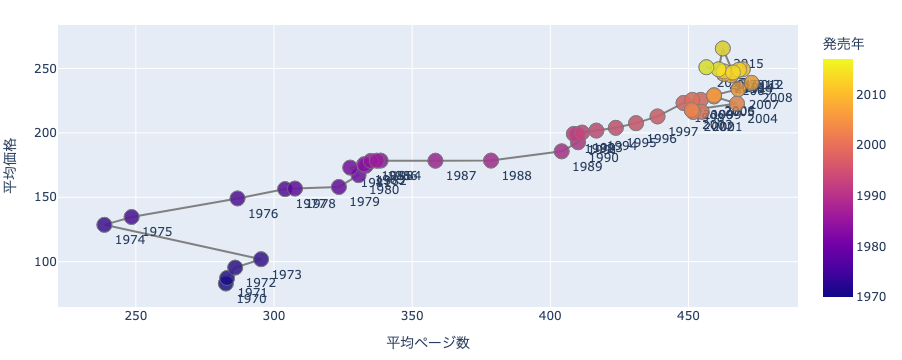

In [16]:
# create_connectedplotを使って連結散布図を作成
# x軸には'平均ページ数'、y軸には'平均価格'、テキストとマーカーの色には'発売年'を設定
fig = create_connectedplot(
    df_cm, x="平均ページ数", y="平均価格", text="発売年", color="発売年"
)

# 作成したグラフを表示する関数 'show_fig' を呼び出し
show_fig(fig)

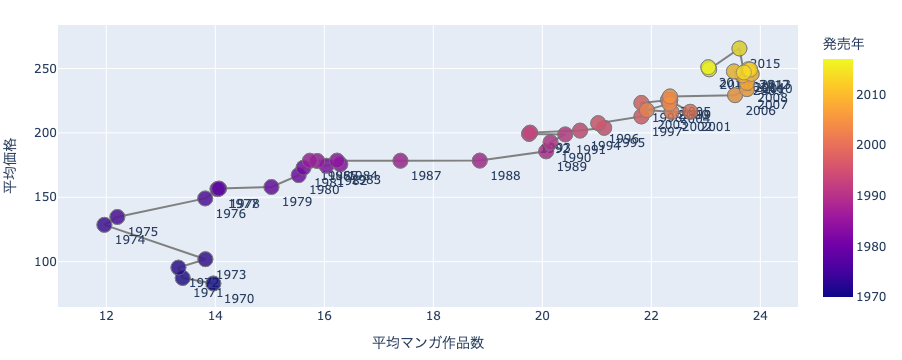

In [17]:
# create_connectedplotを使って連結散布図を作成
# x軸には'平均マンガ作品数'、y軸には'平均価格'、テキストには'発売年'を設定
fig = create_connectedplot(
    df_cm, x="平均マンガ作品数", y="平均価格", text="発売年", color="発売年"
)

# 作成したグラフを表示する関数 'show_fig' を呼び出し
show_fig(fig)

In [18]:
# 'year'と'mcname'でグループ化し、'ccid', 'page_end', 'price'の平均値を計算
# 'reset_index()'を使って、集計後も 'year' 列をデータフレームに保持する
df_cm2 = (
    df_mi.groupby(["year", "mcname"])[["ccid", "page_end", "price"]]
    .mean()
    .reset_index()
)

# 列名を変更して、可視化した際により理解しやすい名前にする
df_cm2 = df_cm2.rename(
    columns={
        "mcname": "マンガ雑誌名",
        "year": "発売年",
        "ccid": "平均マンガ作品数",
        "page_end": "平均ページ数",
        "price": "平均価格",
    }
)

In [19]:
# 可視化対象のDataFrameを確認
df_cm2.head()

,発売年,マンガ雑誌名,平均マンガ作品数,平均ページ数,平均価格
0,1970,週刊少年サンデー,12.333333,284.190476,84.285714
1,1970,週刊少年ジャンプ,14.863636,286.590909,82.727273
2,1970,週刊少年チャンピオン,17.590909,285.272727,82.727273
3,1970,週刊少年マガジン,10.857143,273.904762,82.380952
4,1971,週刊少年サンデー,12.411765,281.666667,86.274510


In [20]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm2, DIR_OUT_CM, "cm2")

DataFrame is saved as '../../../data/cm/output/vol2/04/connected/cm2.csv'.


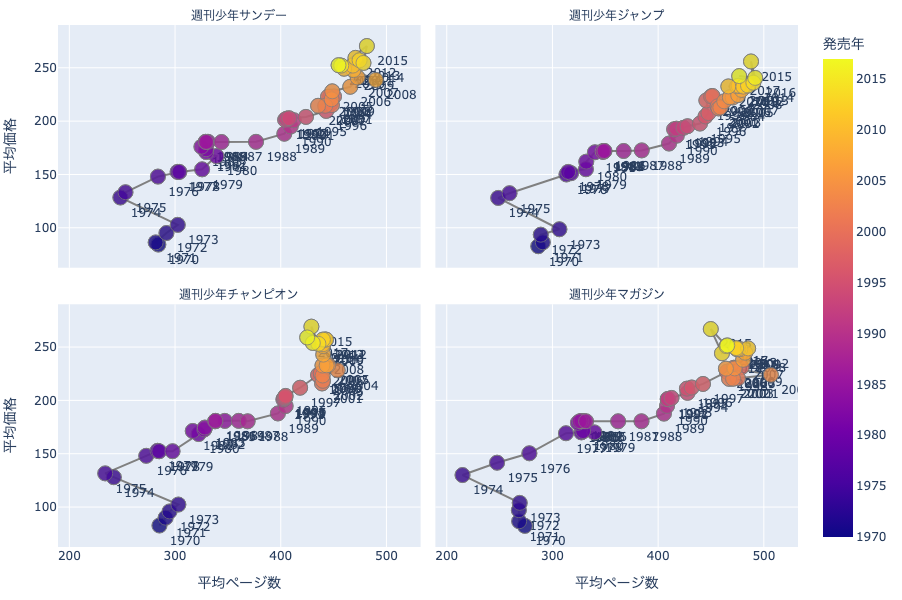

In [21]:
# create_connectedplotを使って連結散布図を作成
# x軸には'平均ページ数'、y軸には'平均価格'、テキストと配色には'発売年'を設定
# マンガ雑誌名でファセットを分け、2列で折り返すよう設定し、高さも調整
fig = create_connectedplot(
    df_cm2,
    x="平均ページ数",
    y="平均価格",
    text="発売年",
    color="発売年",
    facet_col="マンガ雑誌名",
    facet_col_wrap=2,
    height=600,
)

# ファセット（マンガ雑誌ごとの連結散布図）のタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 連結散布図を表示
show_fig(fig)

In [22]:
# テキスト表示用の列を追加：発売年が5の倍数のとき以外はNoneを格納
df_cm2["text"] = df_cm2["発売年"].apply(lambda x: str(x) if x % 5 == 0 else None)

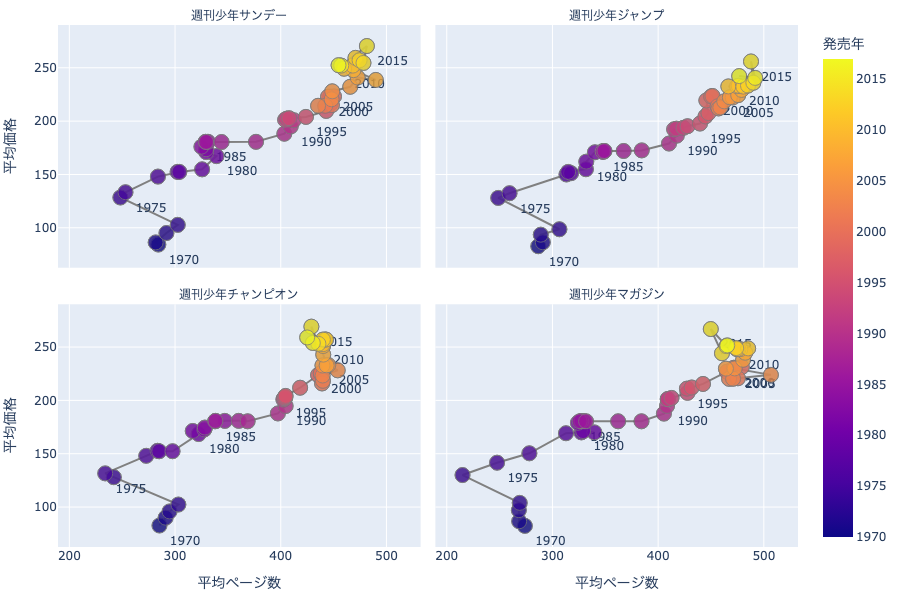

In [23]:
# create_connectedplotを使って連結散布図を作成
# x軸には'平均ページ数'、y軸には'平均価格'、テキストには'text'、配色には'発売年'を設定
# マンガ雑誌名でファセットを分け、2列で折り返すよう設定し、高さも調整
fig = create_connectedplot(
    df_cm2,
    x="平均ページ数",
    y="平均価格",
    text="text",
    color="発売年",
    facet_col="マンガ雑誌名",
    facet_col_wrap=2,
    height=600,
)

# ファセット（マンガ雑誌ごとの連結散布図）のタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 連結散布図を表示
show_fig(fig)

(connected-an)=
### アニメデータ

In [24]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ae = pd.read_csv(DIR_AN / FN_AE)
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)

In [25]:
# acidごとにユニークなaeid数を集計し、n_ae列として格納
df_ac_nae = df_ae.groupby("acid")["aeid"].nunique().reset_index(name="n_ae")
# n_aeについて昇順でソートし、インデックスを更新
df_ac_nae = df_ac_nae.sort_values("n_ae", ignore_index=True)

# 5話以上のアニメ各話と紐付けられているacidを抽出し、acidsとして格納
acids = df_ac_nae[df_ac_nae["n_ae"] >= 5]["acid"].unique().tolist()
# isinメソッドを用い、acidがacidsに含まれる行のみ抽出
df_ae = df_ae[df_ae["acid"].isin(acids)].reset_index(drop=True)

In [26]:
# dateをdatetime型に変換し、yearを取得して列に格納
df_ae["date"] = pd.to_datetime(df_ae["date"])
df_ae["year"] = df_ae["date"].dt.year

# アニメ作品数が極端に少ない1989年以前と、データが途中で打ち切られている2017年は除外
df_ae = df_ae[(df_ae["year"] >= 1990) & (df_ae["year"] <= 2016)].reset_index(drop=True)

# yearごとにユニークなacidとaeid数を集計し格納
# 全てのyearの組合せてに対して行が存在するようアップサンプリング
df_an = df_ae.groupby(["year"])[["acid", "aeid"]].nunique().reset_index()
df_an = upsample_yearly_data(df_an)

# 可視化用にカラム名を変更
df_an = df_an.rename(
    columns={"year": "放送年", "acid": "アニメ作品数", "aeid": "アニメ各話数"}
)

In [27]:
# 可視化対象のDataFrameを確認
df_an.head()

,放送年,アニメ作品数,アニメ各話数
0,1990,17,350
1,1991,52,1749
2,1992,64,1944
3,1993,54,1741
4,1994,59,1919


In [28]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../../data/an/output/vol2/04/connected/an.csv'.


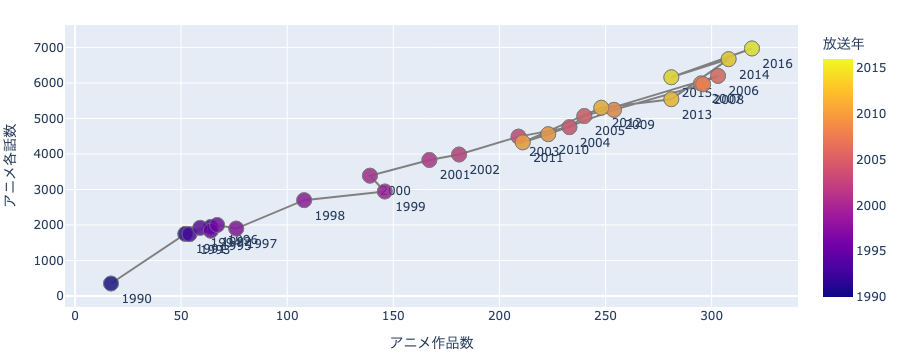

In [29]:
# create_connectedplotを使って連結散布図を作成
# x軸には'アニメ作品数'、y軸には'アニメ各話数'、テキストと配色には'発売年'を設定
fig = create_connectedplot(
    df_an, x="アニメ作品数", y="アニメ各話数", text="放送年", color="放送年"
)

# 連結散布図を表示
show_fig(fig)

In [30]:
# 1994年時点のアニメ作品あたりの平均アニメ各話数
df_tmp = df_an[df_an["放送年"] == 1994].reset_index(drop=True)
ratio = (df_tmp["アニメ各話数"] / df_tmp["アニメ作品数"]).values[0]

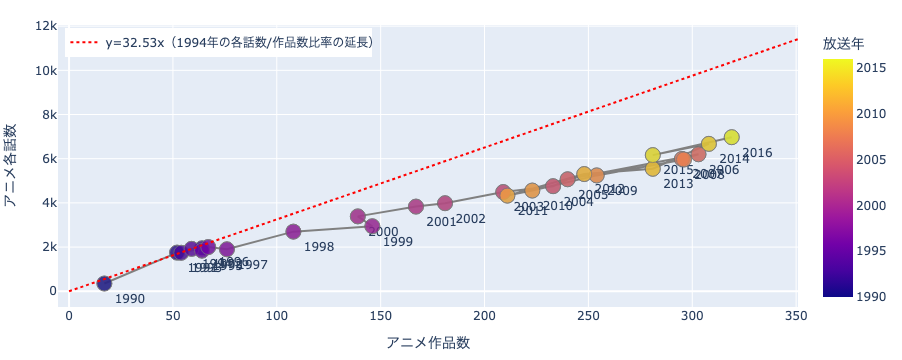

In [31]:
# 直線y=ratio * xの最小値と最大値を規定
# 最小値は0、最大値は連結散布図の最大値の1.1倍
x_line = [0, df_an["アニメ作品数"].max() * 1.1]
y_line = [0, x_line[1] * ratio]

# 2点を使ってy = xの直線を追加
fig.add_trace(
    go.Scatter(
        x=x_line,
        y=y_line,
        mode="lines",
        line={"color": "red", "dash": "dot"},
        name=f"y={ratio:0.4}x（1994年の各話数/作品数比率の延長）",
    )
)

# 凡例の位置を図の右上に固定
# yanchorとxanchorは凡例の基準点（top：上部、right：右端）を指定
# yとxはその基準点の位置を指定
fig.update_layout(legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))

# 連結散布図を表示
show_fig(fig)

(connected-gm)=
### ゲームデータ

In [32]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [33]:
# 'date'列を日付型に変換
df_pkg_pf["date"] = pd.to_datetime(df_pkg_pf["date"])

# 新しい列 'year' を追加して、'date'列から年を抽出
df_pkg_pf["year"] = df_pkg_pf["date"].dt.year

# 新しい列 'weekday' を追加して、'date'列から曜日を抽出
df_pkg_pf["weekday"] = df_pkg_pf["date"].dt.weekday

In [34]:
# 'year'でグループ化し、'pkgid', 'publisher', 'pfname' のユニークな値の数を集計
# 'reset_index()'を使って、集計後にも 'year' 列をデータフレームに保持する
df_gm = (
    df_pkg_pf.groupby("year")[["pkgid", "publisher", "pfname"]].nunique().reset_index()
)

# 2017年までを可視化対象として指定
df_gm = df_gm[df_gm["year"] <= 2017].reset_index(drop=True)

# 'rename'メソッドを使って列名を変更
df_gm = df_gm.rename(
    columns={
        "year": "発売年",
        "pkgid": "ゲームパッケージ数",
        "publisher": "ゲームパブリッシャー数",
        "pfname": "ゲームプラットフォーム数",
    }
)

In [35]:
# 可視化対象のDataFrameを確認
df_gm.head()

,発売年,ゲームパッケージ数,ゲームパブリッシャー数,ゲームプラットフォーム数
0,1982,12,2,1
1,1983,11,4,2
2,1984,30,12,5
3,1985,59,34,7
4,1986,57,31,5


In [36]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../../data/gm/output/vol2/04/connected/gm.csv'.


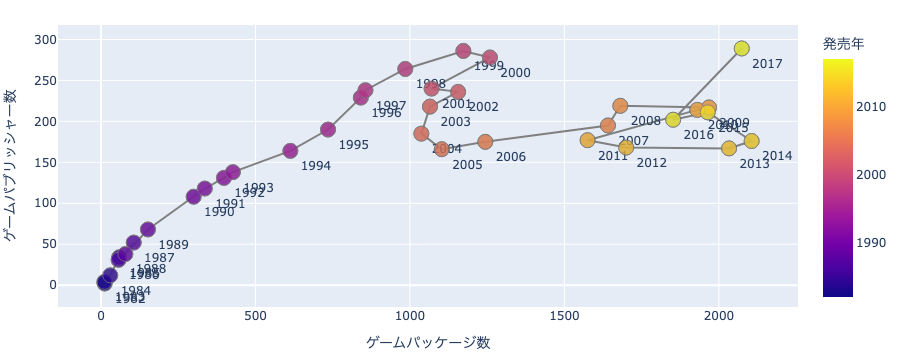

In [37]:
# create_connectedplotを使って連結散布図を作成
# x軸には'ゲームパッケージ数'、y軸には'ゲームパブリッシャー数'、テキストと配色には'発売年'を設定
fig = create_connectedplot(
    df_gm,
    x="ゲームパッケージ数",
    y="ゲームパブリッシャー数",
    text="発売年",
    color="発売年",
)

# 連結散布図を表示
show_fig(fig)

In [38]:
# 'year'と'pfname'でグループ化し、'pkgid'と'publisher'のユニークな値の数を集計
# 'reset_index()'を使って、集計後も 'year' と 'pfname' 列をデータフレームに保持
df_gm2 = (
    df_pkg_pf.groupby(["year", "pfname"])[["pkgid", "publisher"]]
    .nunique()
    .reset_index()
)

# 2017年までを可視化対象として指定
df_gm2 = df_gm2[df_gm2["year"] <= 2017].reset_index(drop=True)

# 'PF2MK'のキーに含まれる 'pfname' のみを保持するためにフィルタリング
# 'isin()' 関数を使って、条件に合う行のみを選択
df_gm2 = df_gm2[df_gm2["pfname"].isin(PF2MK.keys())].reset_index(drop=True)

In [39]:
# 'upsample_yearly_data'関数を使って、年ごとのデータをアップサンプリング
df_gm2 = upsample_yearly_data(df_gm2, "pfname")

# 'map'関数を使って、'pfname'列の値を 'PF2MK' の値に変換し、新しい列 'maker' を作成
df_gm2["maker"] = df_gm2["pfname"].map(PF2MK)

# 可視化用にカラム名をわかりやすいものに変更
df_gm2 = df_gm2.rename(
    columns={
        "pfname": "ゲームプラットフォーム名",
        "pkgid": "ゲームパッケージ数",
        "publisher": "ゲームパブリッシャー数",
        "maker": "メーカー名",
        "year": "発売年",
    }
)

In [40]:
# 可視化対象のDataFrameを表示
df_gm2.head()

,発売年,ゲームプラットフォーム名,ゲームパッケージ数,ゲームパブリッシャー数,メーカー名
0,1983,ファミリーコンピュータ,7,1,任天堂
1,1983,SC-3000,0,0,セガ
2,1983,SG-1000,0,0,セガ
3,1983,SEGAマーク3,0,0,セガ
4,1983,セガ・マスターシステム,0,0,セガ


In [41]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm2, DIR_OUT_GM, "gm2")

DataFrame is saved as '../../../data/gm/output/vol2/04/connected/gm2.csv'.


In [42]:
# メーカー名がソニーのものに絞って可視化
maker = "ソニー"
df_gm2_sony = df_gm2[df_gm2["メーカー名"] == maker].reset_index(drop=True)

In [43]:
# 可視化対象のDataFrameを表示
df_gm2_sony.head()

,発売年,ゲームプラットフォーム名,ゲームパッケージ数,ゲームパブリッシャー数,メーカー名
0,1983,プレイステーション,0,0,ソニー
1,1983,プレイステーション2,0,0,ソニー
2,1983,プレイステーション・ポータブル,0,0,ソニー
3,1983,ゲームアーカイブス,0,0,ソニー
4,1983,プレイステーション3,0,0,ソニー


In [44]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm2_sony, DIR_OUT_GM, "gm2_sony")

DataFrame is saved as '../../../data/gm/output/vol2/04/connected/gm2_sony.csv'.


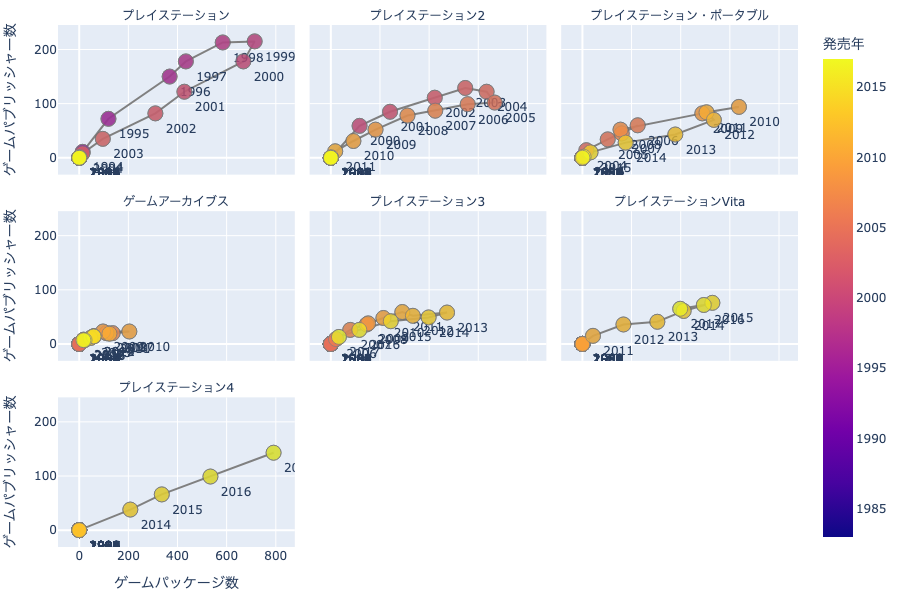

In [45]:
# create_connectedplotを使って連結散布図を作成
# x軸には'ゲームパッケージ数'、y軸には'ゲームパブリッシャー数'、テキストと配色には'発売年'を設定
# 'ゲームプラットフォーム名'ごとにファセットを分けて3列で表示
fig = create_connectedplot(
    df_gm2_sony,
    x="ゲームパッケージ数",
    y="ゲームパブリッシャー数",
    facet_col="ゲームプラットフォーム名",
    facet_col_wrap=3,
    text="発売年",
    color="発売年",
    height=600,
)

# ファセット（プラットフォームごとの連結散布図）のタイトルを簡潔にする処理
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# グラフを表示
show_fig(fig)